## Работа с веб-сайтом Yelp
В этом проекте мы будем работать с базой данных американского веб-сайта Yelp, занимающегося поиском на местном рынке услуг.

Вследствие того, что файл слишком большой, он разделен на 3 части

In [1]:
import numpy as np # Import Numpy library to process big data
import pandas as pd # Import Pandas library to work with files
import seaborn as sns # Import Seaborn library as an addition for Matpotlib
import plotly.express as px # Import Plotly.express module to generate figures rapidly

sns.set(style='whitegrid', font_scale=1.3, palette='Set2') # Set a style, fontsize and pallete for the graphs

#### 1. Город с наибольшим количеством компаний

Загрузим данные из файла `yelp_business.csv` с помощью функции `pd.read_csv`. Посмотрим на случайные строки датасета с помощью метода `sample`.

In [2]:
business_df: pd.DataFrame = pd.read_csv("yelp_business.csv", index_col=0) # Read data from the file by columns
business_df.sample(10) # View 10 random lines from the file

,business_id,name,neighborhood,address,city,state,postal_code,latitude,longitude,is_open,categories
134083,7TGEYxsXdGYrlAQwStZmlg,"""Sears Auto Center""",NaN,"""4900 Midway Mall""",Elyria,OH,44035,41.396935,-82.114124,0,Tires;Auto Repair;Automotive;Oil Change Stations
56485,JhzImIrJ2l_6_LYOdGGFCg,"""Life Coach Elle""",NaN,"""3201 W Peoria Ave""",Phoenix,AZ,85029,33.581278,-112.128629,1,Health & Medical;Life Coach;Professional Servi...
44443,kDIr8ilLpr00I42RbisPUg,"""John C Lawyer, OD""",NaN,"""4023 E Sunset Rd""",Henderson,NV,89014,36.070962,-115.086539,1,Eyewear & Opticians;Health & Medical;Shopping;...
73874,cWr9OhMizMQFXLGuzFil7Q,"""Barburrito - Woodbridge""",NaN,"""8290 Hwy 27, Unit 9""",Woodbridge,ON,L4H 0R9,43.785717,-79.625440,1,Restaurants;Fast Food;Mexican
62321,Sy2EUl9BTQD7uP0h1VUN3Q,"""Nails For You""",Yorkville,"""1168 Bay Street""",Toronto,ON,M5S 2B4,43.668778,-79.389490,1,Nail Salons;Beauty & Spas
69959,mJsE6VxOlQr1tIEY1jrxnw,"""Andre House""",NaN,"""213 S 11th Ave""",Phoenix,AZ,85007,33.445311,-112.086754,1,Local Services;Community Service/Non-Profit
111807,UYZ3-gg7KR5jd72VB9phJg,"""Sushi Itto Japanese Restaurant""",NaN,"""16775 Yonge Street, Suite 13""",Newmarket,ON,L3Y 8J4,44.036372,-79.476028,1,Restaurants;Sushi Bars;Japanese
4442,MjOFnVxoKeOikgBGTZ-UcA,"""Eat'n Park""",NaN,"""7370 McKnight Rd""",Pittsburgh,PA,15237,40.538565,-80.011217,1,Breakfast & Brunch;Diners;American (Traditiona...
120958,JI_PIR0oI6-HsIih9Qm1jw,"""Old Navy""",NaN,"""10025 W McDowell Rd""",Avondale,AZ,85392,33.463182,-112.275148,1,Thrift Stores;Children's Clothing;Fashion;Wome...
55834,w3JBz9gLbZ0CKWQM07nONw,"""Bill Johnson's Big Apple Restaurants""",NaN,"""3757 E Van Buren St""",Phoenix,AZ,85008,33.450696,-112.000052,0,Steakhouses;Restaurants;Barbeque


Наибольший интерес представляют города, для которых имеется наибольшее количество данных о компаниях, поэтому посмотрим, сколько записей есть в пяти  городах с наибольшим их количеством.

In [3]:
business_df["city"].value_counts()[:5] # Count the number of values referred to cities with the biggest number of services

city
Las Vegas     26775
Phoenix       17213
Toronto       17206
Charlotte      8553
Scottsdale     8228
Name: count, dtype: int64

Для дальнейшего анализа удобнее всего выбрать город с наибольшим количеством записей, поэтому оставим только те записи, у которых в колонке 'city' находится значение 'Las Vegas'.

In [4]:
businessLV_df: pd.DataFrame = business_df[business_df["city"] == "Las Vegas"] # Filter data so it refers to Las Vegas
businessLV_df.head(10) # Show data of the first 10 businesses in Las Vegas

,business_id,name,neighborhood,address,city,state,postal_code,latitude,longitude,is_open,categories
6,kCoE3jvEtg6UVz5SOD3GVw,"""BDJ Realty""",Summerlin,"""2620 Regatta Dr, Ste 102""",Las Vegas,NV,89128,36.207430,-115.268460,1,Real Estate Services;Real Estate;Home Services...
7,OD2hnuuTJI9uotcKycxg1A,"""Soccer Zone""",NaN,"""7240 W Lake Mead Blvd, Ste 4""",Las Vegas,NV,89128,36.197484,-115.249660,1,Shopping;Sporting Goods
26,VBHEsoXQb2AQ76J9l8h1uQ,"""Alfredo's Jewelry""",Southeast,"""5775 S Eastern, Ste 103""",Las Vegas,NV,89119,36.085051,-115.119421,1,Shopping;Jewelry;Watch Repair;Local Services
41,1Jp_hmPNUZArNqzpbm7B0g,"""Task Electric""",Spring Valley,"""7260 Cimarron Rd, Ste 130""",Las Vegas,NV,89113,36.056382,-115.269332,1,Home Services;Lighting Fixtures & Equipment;Lo...
48,DPQnTnNw2PJj7DdENM98Cw,"""Star Nursery""",NaN,"""5340 Boulder Hwy""",Las Vegas,NV,89122,36.105196,-115.056880,1,Nurseries & Gardening;Home & Garden;Shopping
49,_F3AMoo_zdl-he384ISQbw,"""Rock of Ages""",NaN,"""3700 W Flamingo Rd""",Las Vegas,NV,89109,36.116965,-115.185696,1,Arts & Entertainment;Performing Arts
52,Pd52CjgyEU3Rb8co6QfTPw,"""Flight Deck Bar & Grill""",Southeast,"""6730 S Las Vegas Blvd""",Las Vegas,NV,89119,36.066914,-115.170848,1,Nightlife;Bars;Barbeque;Sports Bars;American (...
53,4srfPk1s8nlm1YusyDUbjg,"""Subway""",Southeast,"""6889 S Eastern Ave, Ste 101""",Las Vegas,NV,89119,36.064652,-115.118954,1,Fast Food;Restaurants;Sandwiches
54,n7V4cD-KqqE3OXk0irJTyA,"""GameWorks""",Southeast,"""6587 Las Vegas Blvd S, Ste 171""",Las Vegas,NV,89119,36.068259,-115.178877,1,Arcades;Arts & Entertainment;Gastropubs;Restau...
59,Sx0C2RsDgrG3RxBBUoBqTw,"""Kool Radiator Service""",Westside,"""3228 Meade Ave""",Las Vegas,NV,89102,36.136639,-115.184585,1,Automotive;Auto Repair


Изобразим на карте все наши компании и посмотрим, действительно ли они находятся в Лас-Вегасе.

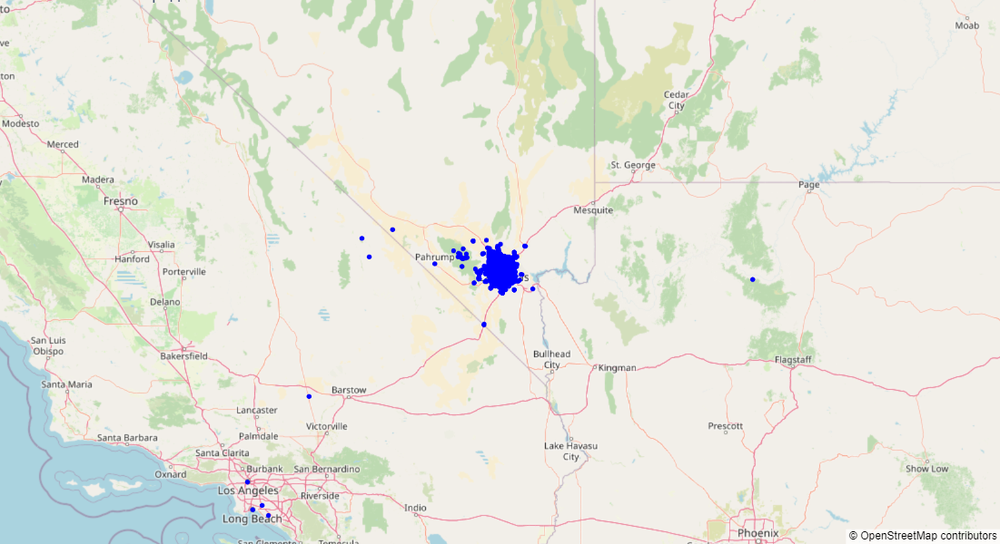

In [5]:
fig = px.scatter_mapbox(data_frame=businessLV_df,                          # Visualize data points on a map using latitude and longitude
                        lat="latitude",                                    # Set latitude 
                        lon="longitude",                                   # Set longitude
                        hover_name="name",                                 # Set which column is displayed in bold as the tooltip title
                        hover_data=["address", "neighborhood", "is_open"], # Set the column names shown in the hover tooltip
                        color_discrete_sequence=["blue"],                  # Set the color for discrete data values
                        zoom=6,                                            # Zoom the map
                        width=800,                                         # Set the map's width
                        height=600,                                        # Set the map's height
                        title="Компании города N")                         # Set the map's title
fig.update_layout(mapbox_style="open-street-map")                          # Set the map's appereance 
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})                        # Set the map's margins
fig.write_html("Vegas companies before clearing.html")                     # Write the figure to an HTML-file
fig.show()                                                                 # Show the map

Сам город находится в сгустке точек. Есть какие-то компании, которые приписаны к этому городу, но находятся далеко от него. Избавимся от них, подобрав некоторые границы значений широты и долготы, и отобразим оставшиеся компании на новом графике.

In [6]:
# Set the borders of Las Vegas
businessLV_df = businessLV_df[(businessLV_df["longitude"] > -115.387)  & (businessLV_df["longitude"] < -114.99)  &
                              (businessLV_df["latitude"] > 35.933) & (businessLV_df["latitude"] < 36.357)]    
# Perlace missing values in the "neighborhood" column with the string "Unknown"
businessLV_df.loc[:,"neighborhood"].fillna("Unknown", inplace=True)

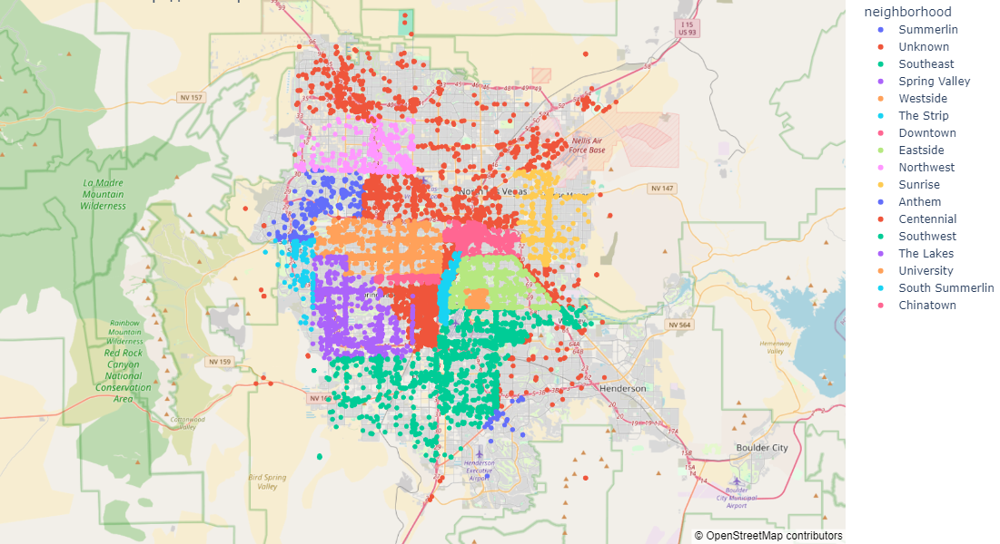

In [7]:
fig = px.scatter_mapbox(data_frame=businessLV_df,                          # Visualize data points on a map using latitude and longitude
                        lat="latitude",                                    # Set latitude 
                        lon="longitude",                                   # Set longitude
                        hover_name="name",                                 # Set which column is displayed in bold as the tooltip title
                        hover_data=["address", "neighborhood", "is_open"], # Set the column names shown in the hover tooltip
                        color = "neighborhood",                            # Classify colors by unique values
                        zoom=9.5,                                          # Zoom the map
                        width=800,                                         # Set the map's width
                        height=600,                                        # Set the map's height
                        title="Компании города N по районам")              # Set the map's title
fig.update_layout(mapbox_style="open-street-map")                          # Set the map's appereance 
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})                        # Set the map's margins 
fig.write_html("Vegas companies after clearing.html")                      # Write the figure to an HTML-file
fig.show()                                                                 # Show the map